## Laboratorium 8.1


## Metody wykrywania ruchu: przepływ optyczny (_optical flow_)

### Wstęp

Na poprzednich laboratoriach poznaliśmy podstawowe metody przetwarzania obrazów, a więc dwuwymiarowych sygnałów przestrzennych. Wiele z tych metod działa także dla (trójwymiarowego) sygnału wideo, jeśli - nieco naiwnie - potraktujemy go jako po prostu sekwencję niezależnych obrazów.

W tej liście wykorzystasz także dziedziną czasową do przetwarzania sygnału. Podstawowa intuicja polega na tym, że jeśli jakiś rejon obrazu przesunął się w czasie, to prawdopodobnie ma on inne _znaczenie_ niż rejon, który pozostał w tym samym miejscu, lub przesunął w innym kierunku czy z inną szybkością. Jeśli zatem jesteśmy w stanie wykryć to przesunięcie - czyli po prostu _ruch_ - to otrzymamy pewną informację o zawartości obrazu (wideo). Na przykład, będziemy w stanie oddzielić poruszające się obiekty od stacjonarnego tła, albo oddzielić inaczej poruszające się obiekty.

Jedną z najpowszechniejszych metodą do automatycznej detekcji ruchu jest znana Ci już z wykładu metoda przepływu optycznego (ang. _optical flow_). Namawiam też do lektury [artykułu z dokumentacji OpenCV](https://docs.opencv.org/3.4/d4/dee/tutorial_optical_flow.html), zwłaszcza sekcji _Lucas-Kanade_ oraz _Dense Optical Flow_. Analizując kod metody, poświęć chwilę na zrozumienie mapowania wyników do prezentowanego obrazu w przestrzeni HSV.

Wiedzieć należy na pewno, że istnieją dwie główne odmiany metody przepływu optycznego:,
* przepływ gęsty (_dense_) - gdzie przesunięcie pomiędzy klatkami określane jest dla każdego piksela (na tej metodzie skupia się niniejsza część listy),
* przepływ rzadki (_sparse_) - gdzie ruch wykrywany jest tylko dla pewnego zbioru punktów zainteresowania w obrębie obrazu (przebadasz ją w drugiej części listy).

W ramach obu odmian występuje pewna liczba konkretnych metod obliczeniowych, w zależności od konkretnego podejścia do rozwiązywania równania ruchu. Na tych zajęciach wykorzystamy [algorytm Farnebacka](http://www.diva-portal.org/smash/get/diva2:273847/FULLTEXT01.pdf) - głównie dlatego, że jego gotowa implementacja znajduje się w pakiecie OpenCV.

### Podejście

Większość algorytmów optical flow operuje na parze klatek, znajdując wektory translacji pomiędzy rejonami z jednej i drugiej. Jeśli więc interesuje nas przetwarzanie ciągłego strumienia wideo, praca przebiegać będzie na zasadzie dwuelementowej kolejki, tzn. zawsze patrzymy na klatkę obecną $I(x,y,t)$ i poprzednią $I(x,y,t-1)$.

OpenCV oferuje banalnie prosty a zarazem potężny interfejs do obsługi strumieni wideo: [`cv2.VideoCapture`](https://docs.opencv.org/3.4/d8/dfe/classcv_1_1VideoCapture.html), za pomocą którego w ten sam sposób możemy obsługiwać pliki wideo w różnym kodowaniu, urządzenia wideo (np. kamerkę w laptopie) czy nawet wideo w protokole IP (choć występują pewne różnice z punktu widzenia użycia, jeśli korzystamy z zasobu sprzętowego działającego w czasie rzeczywistym). Idea jest prosta:
* tworzymy obiekt `cv2.VideoCapture` w odpowiedni sposób,
* pobieramy poszczególne klatki za pomocą metody [`VideoCapture::read`](https://docs.opencv.org/3.4/d8/dfe/classcv_1_1VideoCapture.html#a473055e77dd7faa4d26d686226b292c1).

Metoda `read` wykonuje całą pracę (odczytanie danych, dekodowanie strumienia wideo) i zwraca klatkę jako obraz w standardowym formacie OpenCV (a także flagę, czy w ogóle udało się pozyskać dane - krotka (flaga, klatka)). Zatem, aby pozyskać pierwszą klatkę z pliku wideo wystarczy:
```python
vid = cv2.VideoCapture("back.mp4")
r, frame = vid.read()
```

Drobnym ograniczeniem VideoCapture jest to, że nie ma możliwości cofnięcia się do poprzednio pobranej klatki (co jest naturalne w przypadku korzystania z fizycznego urządzenia do akwizycji, a może trochę mniej gdy czytamy z pliku). Jeśli potrzebny jest powrót do początku pliku wideo, niestety konieczne jest zamknięcie strumienia (`VideoCapture::release`) i ponowne otwarcie (`::open`).

Aby obliczyć (gęsty) przepływ optyczny pomiędzy dwiema klatkami, wykorzystamy algorytm Farnebacka, zaimplementowany w OpenCV w funkcji [`cv2.calcOpticalFlowFarneback`](https://docs.opencv.org/3.4/dc/d6b/group__video__track.html#ga5d10ebbd59fe09c5f650289ec0ece5af). Przyjmuje ona parę obrazów **w skali szarości**, opcjonalny argument `flow` (rozwiązanie można zainicjować poprzednio wyliczonym przepływem, jeśli nim dysponujemy), a następnie szereg parametrów sterujących metodą; m.in. można wykorzystać piramidyzację obrazów (rekomendowane `pyr_size` $=3$) czy określić rozmiar okna detekcji `winsize`. Sensowne pierwsze wartości dla argumentów podane są w dokumentacji.

Algorytm Farnebacka zwraca przepływ w formie obrazu o wymiarach przestrzennych równych obrazom wejściowym i dwóch kanałach, zawierających przesunięcie odpowiednio w osi $x$ i $y$. Można więc przetwarzać te dane dalej, np. obliczając kąt przesunięcia czy całkowitą odległość (i dalej, np. określić prędkość ruchu) - vide np. `cv2.cartToPolar`.

---

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

### Zadanie 1

#### Zadanie 1a
Otwórz wideo `kick.mp4` lub `back.mp4` i pobierz kilka klatek. Przewiń do interesującego Cię momentu - tak, aby uzyskać dwie klatki, na których widać ruch (pro-tip: znając framerate materiału (~25fps) i czas, w którym rozpoczyna się interesujący fragment, możesz w pętli "skonsumować" odpowiednią ilość klatek).  
Wykorzystaj algorytm Farnebacka do obliczenia przepływu pomiędzy klatkami. Wynik zaprezentuj w postaci obrazu całkowitego przesunięcia. W zależności od wybranego momentu w wideo, możesz spodziewać się uzyskania wyraźnych obszarów.

In [2]:
size = 300
radius = size // 2
center = (radius, radius)

x = np.linspace(-radius, radius, size)
y = np.linspace(-radius, radius, size)
X, Y = np.meshgrid(x, y)

angle = np.degrees(np.arctan2(Y, X))
angle = (angle + 360) % 360
distance = np.sqrt(X**2 + Y**2)

hue = angle / 2
saturation = np.clip(distance / radius, 0, 1) * 255
value = np.ones_like(distance) * 255

hsv_colors = np.zeros((size, size, 3), dtype=np.uint8)
hsv_colors[..., 0] = hue.astype(np.uint8)
hsv_colors[..., 1] = saturation.astype(np.uint8)
hsv_colors[..., 2] = value.astype(np.uint8)

hsv_colors = cv2.cvtColor(hsv_colors, cv2.COLOR_HSV2RGB)

In [3]:
def visualize_flow(video_path, frame_number):
    video = cv2.VideoCapture(video_path)
    video.set(cv2.CAP_PROP_POS_FRAMES, frame_number)

    ret1, frame1 = video.read()
    ret2, frame2 = video.read()

    if not ret1 or not ret2:
        print("Error")
        return
    
    gray1 = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)

    flow = cv2.calcOpticalFlowFarneback(gray1, gray2, flow=None, pyr_scale=0.5, levels=3, winsize=15, iterations=3, poly_n=5, poly_sigma=1.1, flags=cv2.OPTFLOW_FARNEBACK_GAUSSIAN)

    magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])

    magnitude_norm = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX)
    angle_norm = cv2.normalize(angle, None, 0, 255, cv2.NORM_MINMAX)
    
    hsv = np.zeros_like(frame1)
    hsv[..., 1] = 255
    hsv[..., 0] = angle * 180 / np.pi / 2
    hsv[..., 2] = magnitude_norm
    bgr_flow = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)

    plt.figure(figsize=(20, 18))
    for i, (img, title, is_gray) in enumerate(zip([cv2.cvtColor(frame1, cv2.COLOR_BGR2RGB), cv2.cvtColor(frame2, cv2.COLOR_BGR2RGB), magnitude_norm, angle_norm, bgr_flow, hsv_colors],
                                         [f'klatka#{frame_number}', f'klatka#{frame_number+1}', 'magnitude', 'angle', 'magnitude + angle', 'colors -> angle'],
                                         [False, False, True, True, False, False])):
        plt.subplot(3, 2, i+1)
        plt.title(title)
        if is_gray:
            plt.imshow(img, cmap='gray')
        else:
            plt.imshow(img) 
        plt.axis('off')

    plt.tight_layout()
    plt.show()

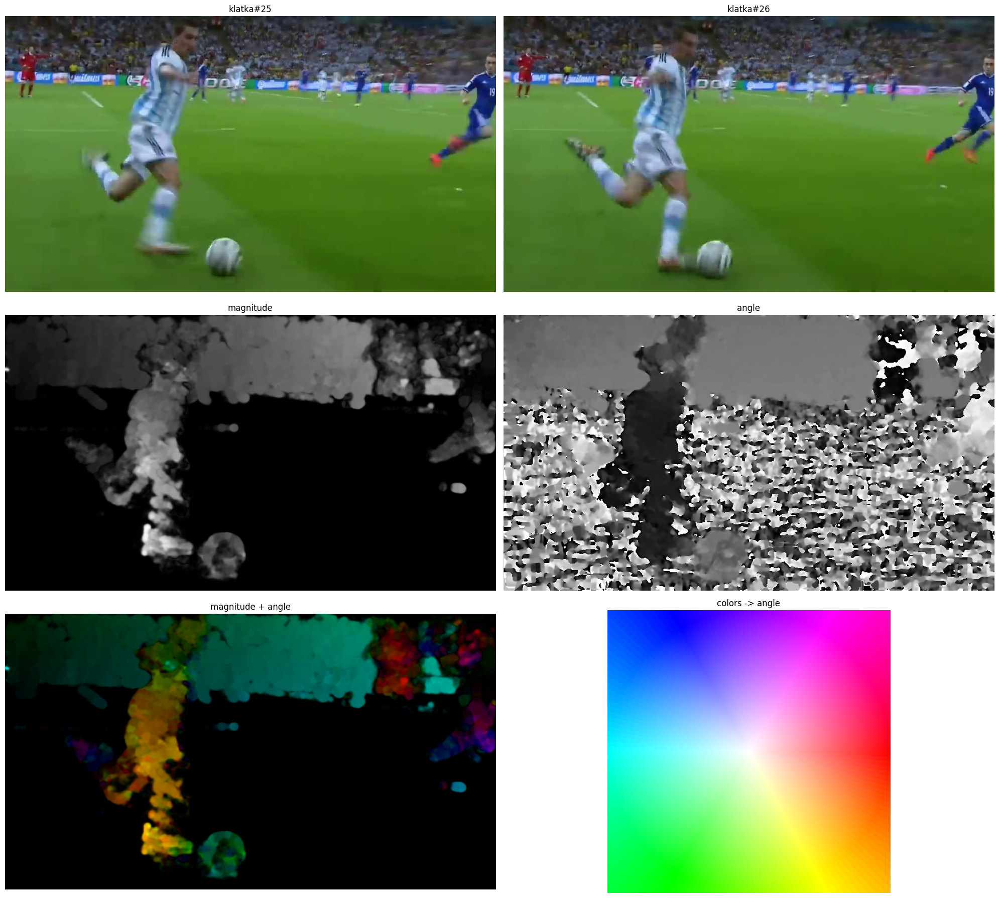

In [4]:
visualize_flow("dane/back.mp4", 25)

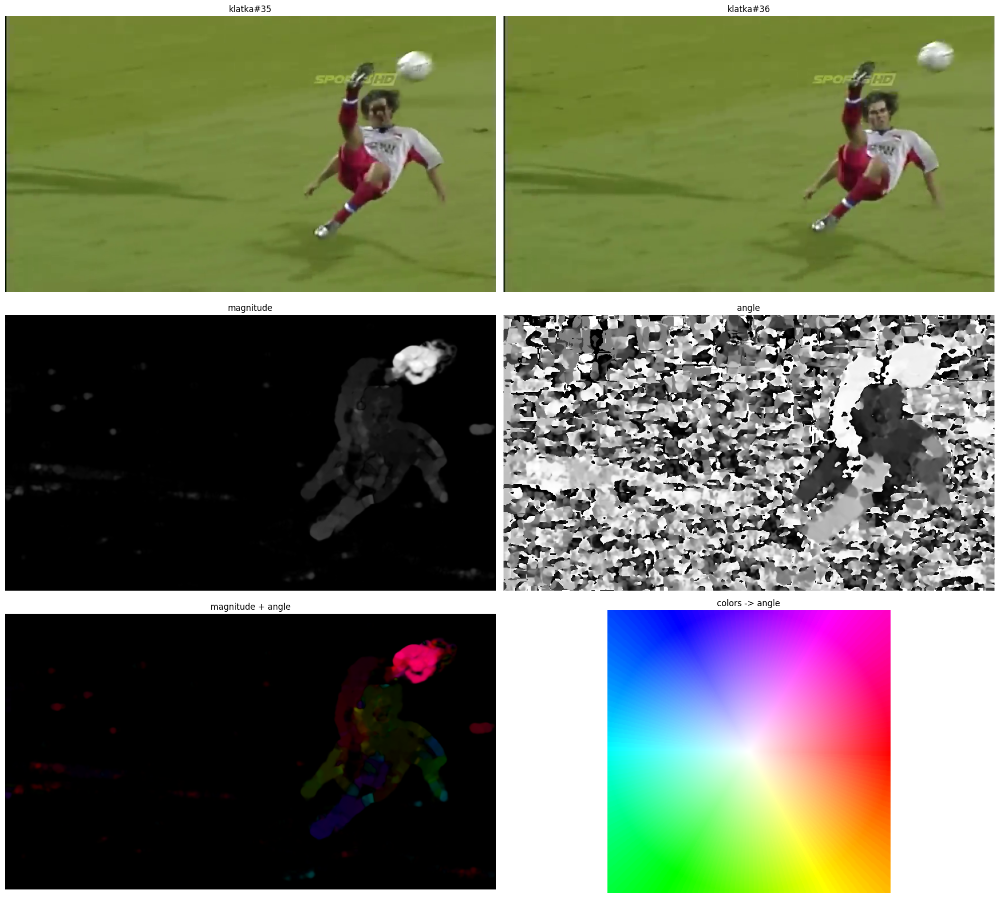

In [5]:
visualize_flow("dane/kick.mp4", 35)

#### Zadanie 1b
Zbadaj wpływ parametru `winsize` na działanie metody.

In [6]:
def test_winsizes(video_path, frame_number, winsizes):
    video = cv2.VideoCapture(video_path)
    video.set(cv2.CAP_PROP_POS_FRAMES, frame_number)

    ret1, frame1 = video.read()
    ret2, frame2 = video.read()

    if not ret1 or not ret2:
        print("Error")
        return
    
    gray1 = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)

    plt.figure(figsize=(20, 6*len(winsizes)))
    for i, winsize in enumerate(winsizes):
        flow = cv2.calcOpticalFlowFarneback(gray1, gray2, flow=None, pyr_scale=0.5, levels=3, winsize=winsize, iterations=3, poly_n=5, poly_sigma=1.1, flags=cv2.OPTFLOW_FARNEBACK_GAUSSIAN)

        magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])

        magnitude_norm = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        angle_norm = cv2.normalize(angle, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

        hsv = np.zeros_like(frame1)
        hsv[..., 1] = 255
        hsv[..., 0] = angle * 180 / np.pi / 2
        hsv[..., 2] = magnitude_norm
        bgr_flow = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

        plt.subplot(len(winsizes), 2, 2 * i + 1)
        plt.title(f'magnitude: winsize={winsize}')
        plt.imshow(bgr_flow)
        plt.axis('off')
        plt.subplot(len(winsizes), 2, 2 * i + 2)
        plt.title(f'angle: winsize={winsize}')
        plt.imshow(angle_norm, cmap='gray')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

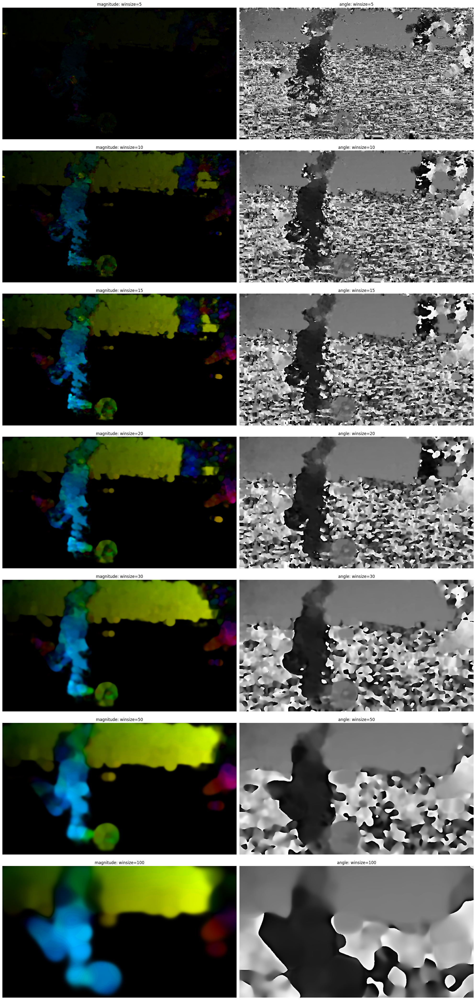

In [8]:
test_winsizes("dane/back.mp4", 25, [5, 10, 15, 20, 30, 50, 100])

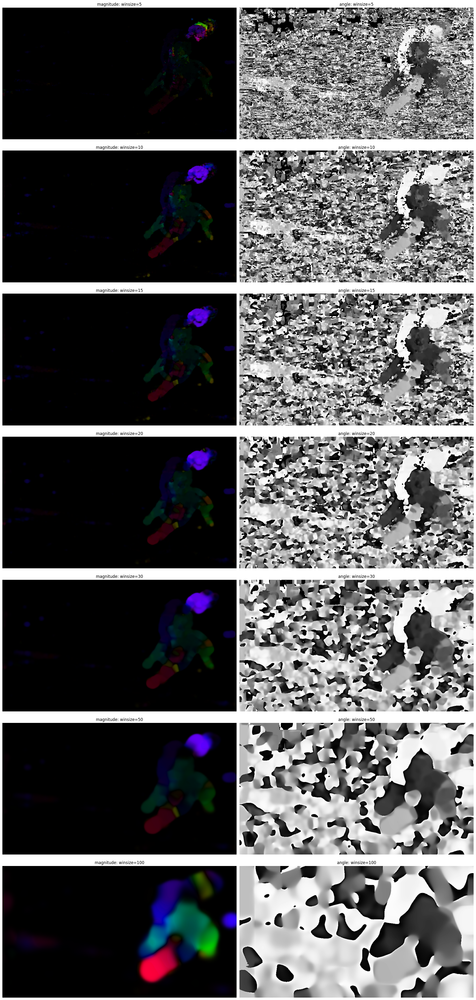

In [9]:
test_winsizes("dane/kick.mp4", 35, [5, 10, 15, 20, 30, 50, 100])

Komentarz 1:

Zwiększanie rozmiaru okna powoduje blurowanie obszarów wykrytego ruchu. Zbyt małe okno nie patrzy na obiekty bardziej całościowo, przez co jest podatne na np. zmianę oświetlenia przy poruszaniu, przez co obiekt poruszający się w jedną stronę jak piłka może zostać podzielony na obszary o różnych kierunkach przemieszczania. 

---

### Zadanie 2

Powtórz powyższy eksperyment na materiale `shot.mp4` (przewiń materiał do momentu natychmiast po uderzeniu białej bili, ok. 20-25 klatek; framerate wynosi tu ok. 15fps).  
*Czy algorytm działa tak samo dobrze? Dlaczego? Co jest ograniczeniem metody?*

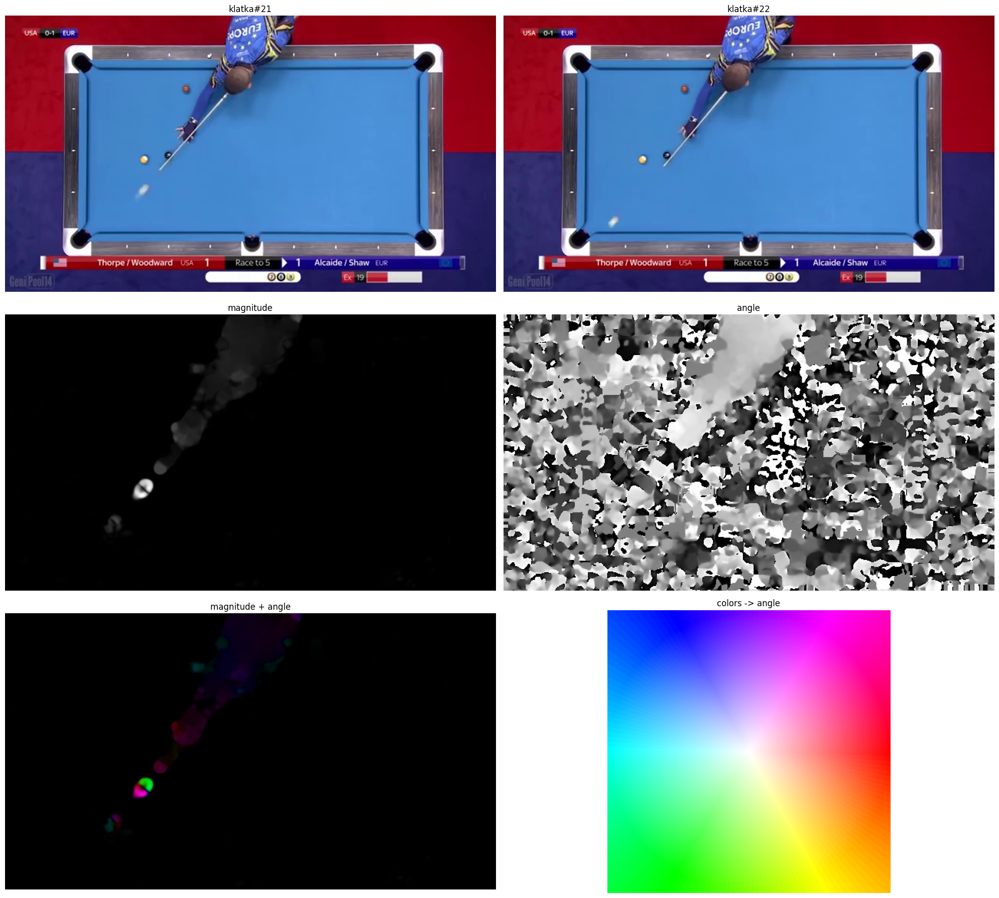

In [89]:
visualize_flow("dane/shot.mp4", 21)

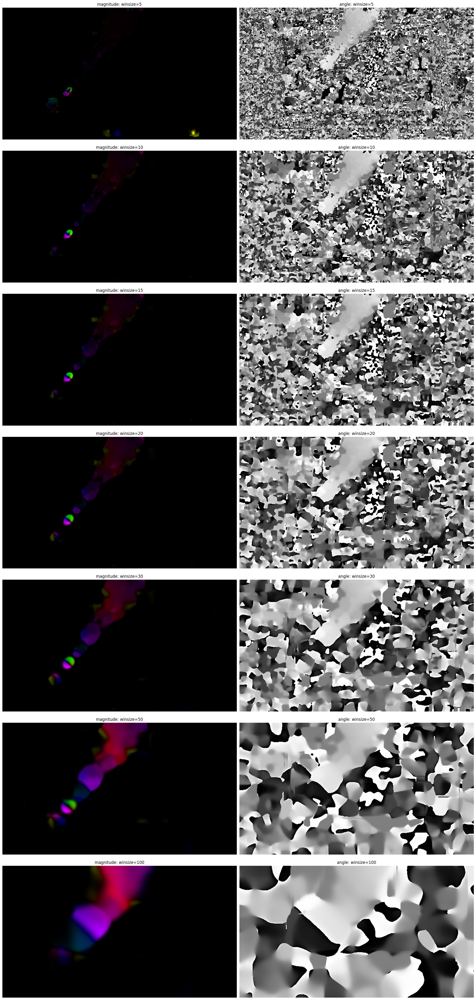

In [10]:
test_winsizes("dane/shot.mp4", 21, [5, 10, 15, 20, 30, 50, 100])

Komentarz 2:

Ruch w powyższym filmiku jest zbyt dynamiczny na poprawne uchwycenie przez kamerę, przez co wychodzą anomalie typu powidok kuli, który zmierza w innym kierunku niż sama kula

### Zadanie dla chętnych

Powróć do takiego przypadku i konfiguracji algorytmu, dla którego uzyskane przez Ciebie wyniki były satysfakcjonujące. Przypomnij sobie zajęcia dotyczące np. segmentacji i wykorzystaj informację o przepływie optycznym do oddzielenia na obrazie obiektów od tła (metoda zupełnie dowolna).

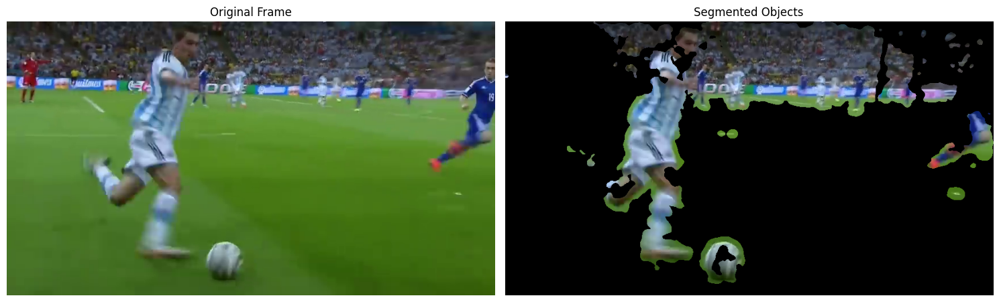

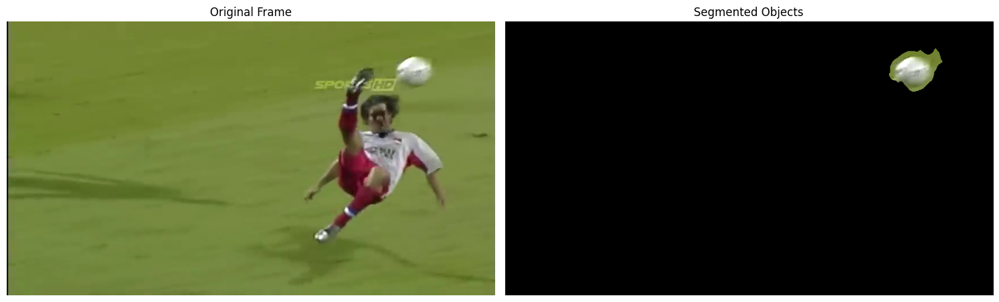

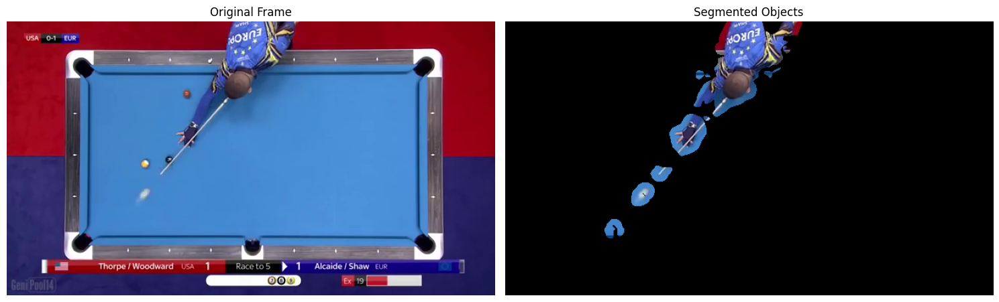

In [21]:
def segment_objects_otsu(video_path, frame_number, winsize=20):
    video = cv2.VideoCapture(video_path)
    video.set(cv2.CAP_PROP_POS_FRAMES, frame_number)

    ret1, frame1 = video.read()
    ret2, frame2 = video.read()

    if not ret1 or not ret2:
        print("Error")
        return
    
    gray1 = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)

    flow = cv2.calcOpticalFlowFarneback(gray1, gray2, flow=None, pyr_scale=0.5, levels=3, winsize=winsize, iterations=3, poly_n=5, poly_sigma=1.1, flags=cv2.OPTFLOW_FARNEBACK_GAUSSIAN)

    magnitude, _ = cv2.cartToPolar(flow[..., 0], flow[..., 1])

    magnitude_8u = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    _, binary_magnitude = cv2.threshold(magnitude_8u, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    segmented_frame = cv2.bitwise_and(frame1, frame1, mask=binary_magnitude)

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 2, 1)
    plt.title('Original Frame')
    plt.imshow(cv2.cvtColor(frame1, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmented Objects')
    plt.imshow(cv2.cvtColor(segmented_frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.tight_layout()
    plt.show()

segment_objects_otsu("dane/back.mp4", 25)
segment_objects_otsu("dane/kick.mp4", 35)
segment_objects_otsu("dane/shot.mp4", 21)